# Lendo dados

In [10]:
import geopandas as gpd
import pandas as pd
import datetime

# Localização das pastas e documentos
shpfdir = 'shapefiles/'
nome_rios = 'AmazonDrainage.shp'
input_file = 'data/'  
shpfdir = 'shapefiles/' 
nome_dados = 'MGB-IPH_DischargeData_AmazonBasin.txt' 
nome_rios = 'AmazonDrainage.shp' 

# Leitura e armazenamento dos dados
rios = gpd.read_file(shpfdir+nome_rios)          # Leitura do shapefile dos rios
Q =  pd.read_csv(input_file+nome_dados, delimiter="\s+",engine='python',header=None) # Leitura da base de dados da vazões

ti='1998-01-01'
tf='2009-12-31'

date = pd.date_range(start=ti, end=tf, freq='D') # Criar um dataframe com as datas
day  = date.day                                  # Cria uma lista com o dia do mes
month= date.month                                # Cria uma lista com o mes
year = date.year                                 # Cria uma lista com o ano

# Q['date'] = date                                 # Cria uma coluna chamada "date" no dataframe das vazões
# Q.set_index('date', inplace=True)                # Seta o indice do dataframe como sendo a coluna "date" ()
Q = Q.values                                  # Armazena od dataFrame "data" na lista "Q"
# rios.tail()

# Armazenando as coordenadas em listas

In [4]:
# Rotina desenvolvida por Samuel Gomes
import plotly.express as px
import shapely.geometry
import numpy as np

# Criação de listas para armazenar coordenadas (latitude-longitude) e nomes dos rios
lats = [] 
lons = []
names = []

for feature, name in zip(rios.geometry, rios.MINI_12): # Itera uma lista com o nome e coordenadas das bacias (zip cria uma tupla)
    #Verifica se feature é linestrings ou multilinestring e armazena em uma variavel de forma iteravel
    if isinstance(feature, shapely.geometry.linestring.LineString):
        linestrings = [feature]
    elif isinstance(feature, shapely.geometry.multilinestring.MultiLineString):
        linestrings = feature.geoms
    else:
        continue
    for linestrings in linestrings: #Armazena latitude, longitude e nomes em suas respectivas listas
        x, y = linestrings.xy       # Leitura das coordenadas da geometria do rio
        lats = np.append(lats, y)   # Armazena a latitude em uma variável "lats"
        lons = np.append(lons, x)   # Armazena a latitude em uma variável "lons"
        names = np.append(names, [name]*len(y)) # Armazena a nome do rio em uma variável "names"
        lats = np.append(lats, None)# espaço vazio
        lons = np.append(lons, None)# espaço vazio
        names = np.append(names, None)# espaço vazio
        

# Construção do mapa

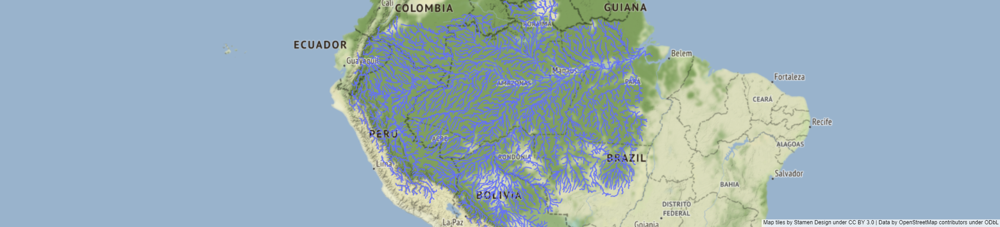

In [5]:
mapa = px.line_mapbox(lat=lats, lon=lons, hover_name=names, height=500) # Plotagem dos rios
mapa.update_layout(mapbox_style="stamen-terrain", mapbox_zoom=4,
                    margin={"r":0,"t":0,"l":0,"b":0})                   # Mapa de fundo 
mapa.show()

# Gráfico de vazão máxima e mínima anual

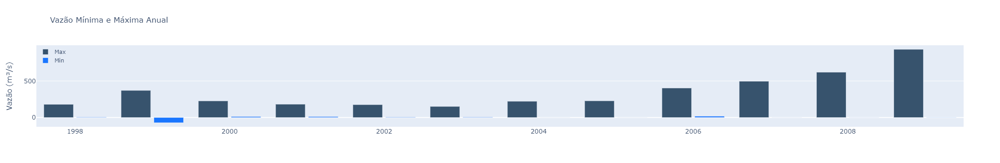

In [6]:
import plotly.graph_objects as go

ano = [x+1 for x in range(1997,2009)]
def minmax_graph(rio):
    np_array = Q#.to_numpy() # transforma o DataFrame em um array
    valor_min =np_array[0][0] # inicializa a variável que armazenará o valor mínimo
    valor_max = 0 # inicializa a variável que armazenará o valor máximo
    list_max = [] # inicializa o array que contém os valores máximos 
    list_min = [] # inicializa o array que contém os valores mínimos
    dias = 0 # inicializa a variável que recebe o valor de dias
    ano = [x+1 for x in range(1997,2009)] # cria um array que contém todos os anos de 1998 até 2009

    for j in range(12): # for para cada ano a ser analizado
        for i in range(365): # for que percorre todos os dias em um ano de um rio da matriz
            if np_array[i+dias][rio]> valor_max: # verifica se o valor atual é maior que o valor anterior
                valor_max = np_array[i+dias][rio] # atualiza o valor máximo se o atual for maior que o anterior
            if np_array[i+dias][rio] < valor_min: # verifica se o valor atual é menor que o valor anterior
                valor_min = np_array[i+dias][rio] # atualiza o valor mínimo se o atual for menor que o anterior
        list_max.append(valor_max) # adicona o valor máximo dentro da lista de valores máximos
        list_min.append(valor_min) # adicona o valor mínimo dentro da lista de valores mpinimos
        valor_min =np_array[1][rio] # limpa a variável de valores mínimos para ir para o próximo ano
        valor_max = 0 # limpa a variável de valores máximos para ir para o próximo ano
        if ano[j]%4==0: # verifica se o ano é bissexto
            dias += 366 # atualiza o valor dos dias se o ano for bissexto
        else:
            dias += 365 # atualiza o valor dos dias se o ano for normal
        
    minmax = go.Figure(data=[
    go.Bar(name='Max', x=ano, y=list_max, marker_color='rgb(55, 83, 109)'),
    go.Bar(name='Min', x=ano, y=list_min, marker_color='rgb(26, 118, 255)')])
        
            # Muda o modo da barra
    minmax.update_layout(barmode='group')

    minmax.update_layout(
        title='Vazão Mínima e Máxima Anual ',
        xaxis_tickfont_size=14,
        yaxis=dict(
            title='Vazão (m³/s)',
            titlefont_size=16,
            tickfont_size=14,
        ),
        legend=dict(
            x=0,
            y=1.0,
            bgcolor='rgba(255, 255, 255, 0)',
            bordercolor='rgba(255, 255, 255, 0)'
        ),
        barmode='group',
        bargap=0.15, # espaço entre barras de coordenadas de localização adjacentes.
        bargroupgap=0.1 # espaço entre as barras da mesma coordenada de localização.
    )
        
    return minmax
minmax_graph(0).show()

# Gráfico das vazões

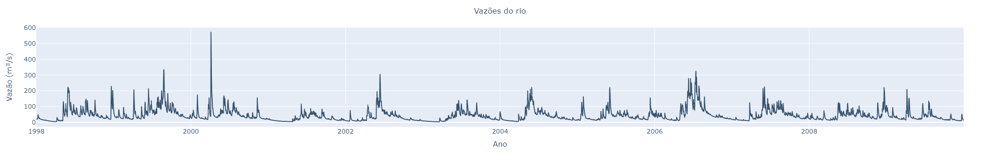

In [7]:
def vazoes_graph(rio):
    vazoes = px.line(Q, x=date, y=rio, color_discrete_sequence=['#37536D'], labels=dict(x="Ano", y="Vazão"))
    vazoes.update_layout(title_text='Vazões do rio', title_x=0.5)
    vazoes.update_yaxes(
            title='Vazão (m³/s)',
            titlefont_size=16,
            tickfont_size=14,
        )
    vazoes.update_xaxes(
            title='Ano',
            titlefont_size=16,
            tickfont_size=14,
        )
    return vazoes
vazoes_graph(0).show()

# Média mensal

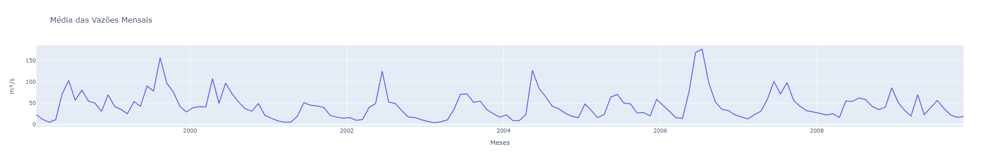

In [11]:
def media_mensal_graph(rio):
    [Rows, Columns] = Q.shape                 # Extrair número de fila (dias) e colunas (rios) da base de dados
    Nmonth = (year[len(year)-1]-year[0]+1)*12 # Número total de mêses na base de dados, assumindo que cada ano tem os 12 meses completos
    Qmean_month=[]#np.zero[Nmonth]      # Aloca lista com média de cada mês 
    date_month=[]
    # Count_days =np.zero[Nmonth]      # Aloca lista com No. de dias de cada mês
    # for river in range(Columns):  # Laço de Rios
    Qtmp = 0; Ntmp=0;cdate=0
    for i in range(1,Rows):     # Laço de dias
        if month[i] == month[i-1]: 
            Qtmp = Qtmp + Q[i,rio] # Acumula a vazão do mês 'month[i]'
            Ntmp+= 1                         # Contador do número de dias do mês 'month[i]'     
        else:
            if year[i] == year[i-1]: # Cria a data onde vai ser plotada minha média mensal
                cdate=str(year[i])+'-'+str(month[i-1])+'-'+str(int(day[i-1]/2))
            else:
                cdate=str(year[i-1])+'-'+str(month[i-1])+'-'+str(int(day[i-1]/2))
            date_month.append(cdate)
            Qmean_month.append(Qtmp/Ntmp)
            Qtmp = Q[i,rio]; Ntmp=1
            
    # Definição das variáveis para a plotagem
    data_i = [go.Scatter(x=date_month,
                   y=Qmean_month,
                   marker = {'color': 'blue',
                             'line': {'color': '#FFFFFF',
                                      'width': 1}
                            },
                   opacity= 0.6)]

    # Layout
    configuracoes_layout = go.Layout(title='Média das Vazões Mensais',
                                     yaxis={'title':'m³/s'},
                                     xaxis={'title':'Meses'})
    # figura
    media_mensal = go.Figure(data=data_i, layout=configuracoes_layout)
    return media_mensal

media_mensal_graph(0).show()

# Ciclo anual

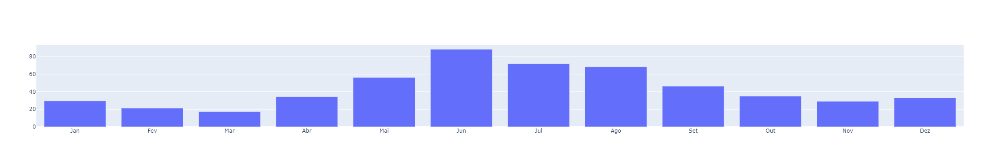

In [12]:
def ciclo_anual_graph(rio):
    [Rows, Columns] = Q.shape   # Extrair número de fila (dias) e colunas (rios) da base de dados
    Nmonth = 12                 # Número de mêses num ano
    Qmonth=np.zeros(Nmonth)     # Aloca lista com média de cada mês 
    Count_days=np.zeros(Nmonth) # Aloca lista com No. de dias de cada mês
    river = 0                   # river: Rio para o qual quer se calcular o ciclo anual
    # for river in range(Columns):  # Laço de Rios
    for i in range(Rows):     # Laço de dias
        mi = month[i]-1       # Indice do mes 'month[i]'
        Qmonth[mi] = Qmonth[mi] + Q[i,rio] # Acumula a vazão do mês 'month[i]'
        Count_days[mi]+= 1                         # Contador do número de dias do mês 'month[i]'     

    for m in range(Nmonth):             # Faz a média 
        Qmonth[m] = Qmonth[m]/Count_days[m]

    meses = ['Jan', 'Fev', 'Mar', 'Abr', 'Mai', 'Jun', 'Jul', 'Ago', 'Set', 'Out', 'Nov', 'Dez']

    ciclo_anual = go.Figure([go.Bar(x=meses, y=Qmonth)])
    return ciclo_anual
    
ciclo_anual_graph(0).show()

# Vazões extremas

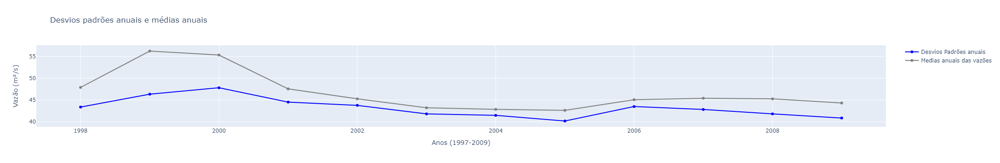

In [21]:
import math
import numpy as np

def desvio_media(rio):
    np_array= Q # transforma o DataFrame em um array
    lista1= [] # cria uma lista para armazenar as vazões que serão usadas no cálculo do desvio padrão 
    lista = [] # cria uma lista para armazenar as vazões que serão plotadas
    media2 = [] # cria uma lista para armazenar as médias anuais que serão usadas no cálculo do desvio padrão
    mediagraf = [] #cria uma lista para as médias anuais que serão plotadas
    mmf2 = [] #define uma lista para poder subtrair a média de todas as vazões anuais  
    mmf22 = []#define uma lista para elevar os valores da lista mmf ao quadrado
    somatoriammf22 = [] #define uma lista para aramazenar a soma de todos os valores da lista mmf2
    dp2 = [] #define uma lista para dividir o resultado da lista anterior pelo total de vazões anuais 
    dpf2 = [] #define uma lista para tirar a raiz dos resultados da lista anterior
    dpff2 = [] #cria uma lista que armazena o resultado final do desvio padrão e multiplica por 2 para separar as vazões acima e abaixo da média depois
    dpfff = [] #cria uma lista para armazenar os desvios padrões que serão plotados
    va = 0 #variável que irá receber a quantidade de dias em que as vazões ficaram acima da média
    vb = 0 #variável que irá receber a quantidade de dias em que as vazões ficaram abaixo da média 
    media = [] # cria uma lista para armazenar a média de todas as vazões do rio nos 12 anos para efetuar o cálculo do desvio padrão
    mmf = [] #define uma lista para poder subtrair a média de todas as vazões do rio
    mmf1 = []#define uma lista para elevar os valores da lista mmf ao quadrado
    somatoriammf1 = [] #define uma lista para aramazenar a soma de todos os valores da lista mmf1
    dp = [] #define uma lista para dividir o resultado da lista anterior pelo total de vazões anuais 
    dpf = [] #define uma lista para tirar a raiz dos resultados da lista anterior
    dias = 0 # inicializa a variável que recebe o valor de dias
    ano = [x+1 for x in range(1997,2009)] # cria um array que contém todos os anos de 1998 até 2009
    rio=0
    for j in range(len(ano)):                           # for para cada ano a ser analizado
        for i in range(365):                            # for que percorre todos os dias em um ano de um rio da matriz
            lista1.append(np_array[i+dias][rio])        #acrescenta as vazões anuais na lista
        media2 = [sum(lista1)/len(lista1)]              # calcula a média anual das vazões na lista1
        mediagraf.append(media2[0])                     # acrescenta a média anual na lista das médias anuais que serão plotadas
        for l in lista1: #for que percorre a lista1
            mmf22.append((l - media2[0])**2)            # subtrai o valor da média anual de todos os valores na lista1 como parte do cálculo do desvio padrão e joga o resultado na lista mmf2
        somatoriammf22 =[sum(mmf22)]                    # lista que recebe a soma de todos os valores na lista mmf22

        dp2 = [float(i)/(len(lista1)-1) for i in somatoriammf22] #divide todos os valores na lista anterior e joga o resultado na lista dp2
        dpf2 = [math.sqrt(dp2[0])] #se forem maiores que 0, o loop retira a raiz quadrada desses valores e joga o resultado na lista dpf2

        for m in dpf2: #for que percorre a lista dpf2
            dpfff.append(m)# acrescenta o resultado final do desvio padrão anual na lista dpfff para plotar esse resultados no final

        if ano[j]%4==0: # verifica se o ano é bissexto
            dias += 366 # atualiza o valor dos dias se o ano for bissexto
        else:
            dias += 365 # atualiza o valor dos dias se o ano for normal

        media2 = [] #limpa a lista para seguir para o próximo ano
        mmf2 = [] #limpa a lista para seguir para o próximo ano
        mmf22 = [] #limpa a lista para seguir para o próximo ano
        somatoriammf22 = [] #limpa a lista para seguir para o próximo ano
        dp2 = [] #limpa a lista para seguir para o próximo ano
        dpf2 = [] #limpa a lista para seguir para o próximo ano


    #no próximo loopo iremos calcular o desvio padrão para todas as vazões do rio escolhido e também a sua média no mesmo processo
    # desta maneira poderemos em seguida desenvolver outro loop para encontrar as vazões abaixo e acima da média levando em conta o desvio padrão

    for k in lista1: # for que percorre a lista1 que já possui as vazões da matriz
        media = [sum(lista1)/len(lista1)] # calcula a média anual das vazões na lista1
    for l in lista1: #for que percorre a lista1
        mmf.append(l - media[0]) #subtrai o valor da média anual de todos os valores na lista1 como parte do cálculo do desvio padrão e joga o resultado na lista mmf
    for l in mmf: #for que percorre a lista mmf
        mmf1.append(l**2) #eleva os valoreds na lista mmf e acrescenta o resultado na lista mmf1
    somatoriammf1 =[sum(mmf1)] #lista que recebe a soma de todos os valores na lista mmf1
    dp = [float(i)/len(lista1)-1 for i in somatoriammf1] #divide todos os valores na lista anterior e joga o resultado na lista dp
    for n in dp: #for que percorre a lista dp
        if n > 0: #analisa se os valores  na lista dp são maiores que 0
            dpf = [math.sqrt(dp[0])] #se forem maiores que 0, o loop retira a raiz quadrada desses valores e joga o resultado na lista dpf 
        if n < 0:#analisa se o valor na lista dp são menores que 0
            dpf.append(n)#se forem menores acrescenta esse valor sem tirar a raiz pois não existe raiz de negativos no reais

    #!!!!!!o valor na lista dpf é o desvio padrão de todas as vazões do rio!!!!!!

    for n in dpf: 
        dpff2.append(n*2) #multiplica o desvio padrão de todas as vazões na lista dpf e joga o resultados na lista dpff2
    for i in lista1: # laço de repetição para percorrer as colunas e separar os dias das vazões acima e abaixo da média.
        if i > media[0] + dpff2[0]: # condicional para separar os dias de vazão acima da média mais duas vezes o desvio padrão.
            va += 1    # armazena a quantidade de dias que a vazão foi maior que média.
        elif i < media[0] - dpff2[0]: # condicional para separar os dias de vazão abaixo da média.
            vb +=1      # armazena a quantidade de dias que a vazão foi menor que média menos duas vezes o desvio padrão.


    x = (4380 - (va+vb)) # subtrai a soma entre va e vb do total de vazões par saber quantas vazões não estão acima ou abaixo da média com o desvio padrão

#as variáveis va e vb irão indicar o número de dias em que as vazões dos rios ficaram abaixo ou acima da média anual levando em conta o desvio padrão anual

    trace3 = go.Scatter(x = ano, y = dpfff, mode = 'markers+lines', name = 'Desvios Padrões anuais', marker_color= 'blue') #define os desvios padrões anuais em y e a cor da linha 

    trace2 = go.Scatter(x = ano, y = mediagraf, mode = 'markers+lines', name = 'Medias anuais das vazões', marker_color= 'grey') #define as médias anuais como sendo y e a cor da linha 

    # define o título do gráfico e os títulos dos eixos

    layout = go.Layout(title='Desvios padrões anuais e médias anuais',
                       yaxis={'title':'Vazão (m³/s)'},
                       xaxis={'title': 'Anos (1997-2009)'})

    data = [trace3, trace2] #define as variáveis que serão plotadas

    desvio = go.Figure(data=data, layout=layout)

    return desvio
    
desvio_media(0).show()

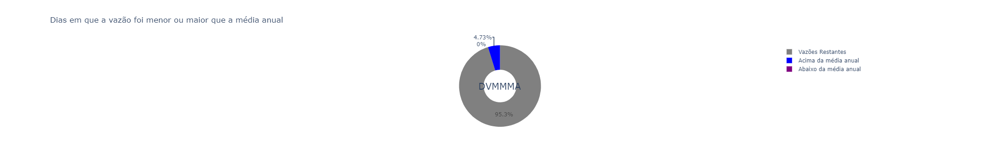

In [19]:
import math
import numpy as np
import plotly.offline as py

def vazoes_extremas(rio):
    np_array= Q # transforma o DataFrame em um array
    lista1= [] # cria uma lista para armazenar as vazões que serão usadas no cálculo do desvio padrão 
    lista = [] # cria uma lista para armazenar as vazões que serão plotadas
    media2 = [] # cria uma lista para armazenar as médias anuais que serão usadas no cálculo do desvio padrão
    mediagraf = [] #cria uma lista para as médias anuais que serão plotadas
    mmf2 = [] #define uma lista para poder subtrair a média de todas as vazões anuais  
    mmf22 = []#define uma lista para elevar os valores da lista mmf ao quadrado
    somatoriammf22 = [] #define uma lista para aramazenar a soma de todos os valores da lista mmf2
    dp2 = [] #define uma lista para dividir o resultado da lista anterior pelo total de vazões anuais 
    dpf2 = [] #define uma lista para tirar a raiz dos resultados da lista anterior
    dpff2 = [] #cria uma lista que armazena o resultado final do desvio padrão e multiplica por 2 para separar as vazões acima e abaixo da média depois
    dpfff = [] #cria uma lista para armazenar os desvios padrões que serão plotados
    va = 0 #variável que irá receber a quantidade de dias em que as vazões ficaram acima da média
    vb = 0 #variável que irá receber a quantidade de dias em que as vazões ficaram abaixo da média 
    media = [] # cria uma lista para armazenar a média de todas as vazões do rio nos 12 anos para efetuar o cálculo do desvio padrão
    mmf = [] #define uma lista para poder subtrair a média de todas as vazões do rio
    mmf1 = []#define uma lista para elevar os valores da lista mmf ao quadrado
    somatoriammf1 = [] #define uma lista para aramazenar a soma de todos os valores da lista mmf1
    dp = [] #define uma lista para dividir o resultado da lista anterior pelo total de vazões anuais 
    dpf = [] #define uma lista para tirar a raiz dos resultados da lista anterior
    dias = 0 # inicializa a variável que recebe o valor de dias
    ano = [x+1 for x in range(1997,2009)] # cria um array que contém todos os anos de 1998 até 2009
    rio=0
    for j in range(len(ano)):                           # for para cada ano a ser analizado
        for i in range(365):                            # for que percorre todos os dias em um ano de um rio da matriz
            lista1.append(np_array[i+dias][rio])        #acrescenta as vazões anuais na lista
        media2 = [sum(lista1)/len(lista1)]              # calcula a média anual das vazões na lista1
        mediagraf.append(media2[0])                     # acrescenta a média anual na lista das médias anuais que serão plotadas
        for l in lista1: #for que percorre a lista1
            mmf22.append((l - media2[0])**2)            # subtrai o valor da média anual de todos os valores na lista1 como parte do cálculo do desvio padrão e joga o resultado na lista mmf2
        somatoriammf22 =[sum(mmf22)]                    # lista que recebe a soma de todos os valores na lista mmf22

        dp2 = [float(i)/(len(lista1)-1) for i in somatoriammf22] #divide todos os valores na lista anterior e joga o resultado na lista dp2
        dpf2 = [math.sqrt(dp2[0])] #se forem maiores que 0, o loop retira a raiz quadrada desses valores e joga o resultado na lista dpf2

        for m in dpf2: #for que percorre a lista dpf2
            dpfff.append(m)# acrescenta o resultado final do desvio padrão anual na lista dpfff para plotar esse resultados no final

        if ano[j]%4==0: # verifica se o ano é bissexto
            dias += 366 # atualiza o valor dos dias se o ano for bissexto
        else:
            dias += 365 # atualiza o valor dos dias se o ano for normal

        media2 = [] #limpa a lista para seguir para o próximo ano
        mmf2 = [] #limpa a lista para seguir para o próximo ano
        mmf22 = [] #limpa a lista para seguir para o próximo ano
        somatoriammf22 = [] #limpa a lista para seguir para o próximo ano
        dp2 = [] #limpa a lista para seguir para o próximo ano
        dpf2 = [] #limpa a lista para seguir para o próximo ano


    #no próximo loopo iremos calcular o desvio padrão para todas as vazões do rio escolhido e também a sua média no mesmo processo
    # desta maneira poderemos em seguida desenvolver outro loop para encontrar as vazões abaixo e acima da média levando em conta o desvio padrão

    for k in lista1: # for que percorre a lista1 que já possui as vazões da matriz
        media = [sum(lista1)/len(lista1)] # calcula a média anual das vazões na lista1
    for l in lista1: #for que percorre a lista1
        mmf.append(l - media[0]) #subtrai o valor da média anual de todos os valores na lista1 como parte do cálculo do desvio padrão e joga o resultado na lista mmf
    for l in mmf: #for que percorre a lista mmf
        mmf1.append(l**2) #eleva os valoreds na lista mmf e acrescenta o resultado na lista mmf1
    somatoriammf1 =[sum(mmf1)] #lista que recebe a soma de todos os valores na lista mmf1
    dp = [float(i)/len(lista1)-1 for i in somatoriammf1] #divide todos os valores na lista anterior e joga o resultado na lista dp
    for n in dp: #for que percorre a lista dp
        if n > 0: #analisa se os valores  na lista dp são maiores que 0
            dpf = [math.sqrt(dp[0])] #se forem maiores que 0, o loop retira a raiz quadrada desses valores e joga o resultado na lista dpf 
        if n < 0:#analisa se o valor na lista dp são menores que 0
            dpf.append(n)#se forem menores acrescenta esse valor sem tirar a raiz pois não existe raiz de negativos no reais

    #!!!!!!o valor na lista dpf é o desvio padrão de todas as vazões do rio!!!!!!

    for n in dpf: 
        dpff2.append(n*2) #multiplica o desvio padrão de todas as vazões na lista dpf e joga o resultados na lista dpff2
    for i in lista1: # laço de repetição para percorrer as colunas e separar os dias das vazões acima e abaixo da média.
        if i > media[0] + dpff2[0]: # condicional para separar os dias de vazão acima da média mais duas vezes o desvio padrão.
            va += 1    # armazena a quantidade de dias que a vazão foi maior que média.
        elif i < media[0] - dpff2[0]: # condicional para separar os dias de vazão abaixo da média.
            vb +=1      # armazena a quantidade de dias que a vazão foi menor que média menos duas vezes o desvio padrão.


    x = (4380 - (va+vb)) # subtrai a soma entre va e vb do total de vazões par saber quantas vazões não estão acima ou abaixo da média com o desvio padrão

    #o gráfico de pizza irá mostrar o total de vazões acima e abaixo da média levando em conta o desvio padrão


    labels = ['Acima da média anual','Abaixo da média anual', 'Vazões Restantes']  # subtítulos do gráfico.
    values = [va, vb, x]   # armazena na variável values a lista dos valores obtidos.

    night_colors = ['blue', 'purple', 'grey'] # altera as cores do gráfico de pizza de acordo com os parâmetros.

    vazoes_ext = go.Figure(data=[go.Pie(labels=labels, values=values, marker_colors=night_colors)]) # armazena na variável fig a configuração do gráfico.
    vazoes_ext.update_layout(                                                         # atualiza o layout do gráfico.
        title_text="Dias em que a vazão foi menor ou maior que a média anual", # adiciona título.
        annotations=[dict(text='DVMMMA', x=0.5, y=0.5, font_size=20, showarrow=False)]) # adiciona a sigla DVMMMA no meio do gráfico. 
    vazoes_ext.update_traces(hole=.4, hoverinfo="label+percent+name")  # configura o tamanho da circunferência no interior do gráfico.

    return vazoes_ext
vazoes_extremas(0).show()

In [22]:
import json
import dash
import dash_core_components as dcc
import dash_html_components as html
from dash.dependencies import Input, Output

app = dash.Dash(__name__)

fig.update_layout(clickmode='event+select')

app.layout = html.Div([
    dcc.Graph(
        id='mapa',
        figure=mapa
    ),
    dcc.Graph(
        id='vazoes',
        figure=vazoes_graph(0)
    ),
    dcc.Graph(
        id='minmax',
        figure=minmax_graph(0)
    ),
    dcc.Graph(
        id='desvio',
        figure=desvio_media(0)
    ),
    dcc.Graph(
        id='rosquinha',
        figure=vazoes_extremas(0)
    ),
    dcc.Graph(
        id='media_mensal',
        figure=media_mensal_graph(0)
    ),
    dcc.Graph(
        id='ciclo_anual',
        figure=ciclo_anual_graph(0)
    ),
#     html.Div([
#             html.Pre(id='click-data'),
#         ])
])

@app.callback(
    Output('click-data', 'children'),
    Input('mapa', 'clickData'))
def display_click_data(clickData):
    return json.dumps(clickData, indent=2)

@app.callback(
    Output('vazoes', 'figure'),
    Input('click-data', 'children'))
def atualizar_vazoes(rio):
    rio = json.loads(rio)
    rio = rio['points'][0]['hovertext'] 
    return vazoes_graph(rio)

@app.callback(
    Output('media_mensal', 'figure'),
    Input('click-data', 'children'))
def atualizar_medias_mensais(rio):
    rio = json.loads(rio)
    rio = rio['points'][0]['hovertext'] - 1  
    return media_mensal_graph(rio)

@app.callback(
    Output('rosquinha', 'figure'),
    Input('click-data', 'children'))
def atualizar_rosquinha(rio):
    rio = json.loads(rio)
    rio = rio['points'][0]['hovertext'] - 1
    return vazoes_extremas(rio)

@app.callback(
    Output('ciclo_anual', 'figure'),
    Input('click-data', 'children'))
def atualizar_ciclo_anual(rio):
    rio = json.loads(rio)
    rio = rio['points'][0]['hovertext'] - 1
    return ciclo_anual_graph(rio)

@app.callback(
    Output('minmax', 'figure'),
    Input('click-data', 'children'))
def atualizar_minmax(rio):
    rio = json.loads(rio)
    rio = rio['points'][0]['hovertext'] - 1
    return minmax_graph(rio)

app.run_server()

Dash is running on http://127.0.0.1:8050/

Dash is running on http://127.0.0.1:8050/

Dash is running on http://127.0.0.1:8050/

Dash is running on http://127.0.0.1:8050/

 * Serving Flask app "__main__" (lazy loading)
 * Environment: production
   Use a production WSGI server instead.
 * Debug mode: off


 * Running on http://127.0.0.1:8050/ (Press CTRL+C to quit)
127.0.0.1 - - [30/Sep/2021 17:42:56] "GET / HTTP/1.1" 200 -
127.0.0.1 - - [30/Sep/2021 17:42:57] "GET /_dash-dependencies HTTP/1.1" 200 -
127.0.0.1 - - [30/Sep/2021 17:42:57] "GET /_dash-layout HTTP/1.1" 200 -
127.0.0.1 - - [30/Sep/2021 17:42:57] "GET /_dash-component-suites/dash/dcc/async-graph.js HTTP/1.1" 200 -
127.0.0.1 - - [30/Sep/2021 17:42:57] "GET /_dash-component-suites/dash/dcc/async-plotlyjs.js HTTP/1.1" 200 -
127.0.0.1 - - [30/Sep/2021 17:42:58] "POST /_dash-update-component HTTP/1.1" 200 -


Exception on /_dash-update-component [POST]
Traceback (most recent call last):
  File "C:\Users\GABRIEL\anaconda3\lib\site-packages\flask\app.py", line 2447, in wsgi_app
    response = self.full_dispatch_request()
  File "C:\Users\GABRIEL\anaconda3\lib\site-packages\flask\app.py", line 1952, in full_dispatch_request
    rv = self.handle_user_exception(e)
  File "C:\Users\GABRIEL\anaconda3\lib\site-packages\flask\app.py", line 1821, in handle_user_exception
    reraise(exc_type, exc_value, tb)
  File "C:\Users\GABRIEL\anaconda3\lib\site-packages\flask\_compat.py", line 39, in reraise
    raise value
  File "C:\Users\GABRIEL\anaconda3\lib\site-packages\flask\app.py", line 1950, in full_dispatch_request
    rv = self.dispatch_request()
  File "C:\Users\GABRIEL\anaconda3\lib\site-packages\flask\app.py", line 1936, in dispatch_request
    return self.view_functions[rule.endpoint](**req.view_args)
  File "C:\Users\GABRIEL\anaconda3\lib\site-packages\dash\dash.py", line 1336, in dispatch
    

127.0.0.1 - - [30/Sep/2021 17:42:58] "POST /_dash-update-component HTTP/1.1" 500 -


Exception on /_dash-update-component [POST]
Traceback (most recent call last):
  File "C:\Users\GABRIEL\anaconda3\lib\site-packages\flask\app.py", line 2447, in wsgi_app
    response = self.full_dispatch_request()
  File "C:\Users\GABRIEL\anaconda3\lib\site-packages\flask\app.py", line 1952, in full_dispatch_request
    rv = self.handle_user_exception(e)
  File "C:\Users\GABRIEL\anaconda3\lib\site-packages\flask\app.py", line 1821, in handle_user_exception
    reraise(exc_type, exc_value, tb)
  File "C:\Users\GABRIEL\anaconda3\lib\site-packages\flask\_compat.py", line 39, in reraise
    raise value
  File "C:\Users\GABRIEL\anaconda3\lib\site-packages\flask\app.py", line 1950, in full_dispatch_request
    rv = self.dispatch_request()
  File "C:\Users\GABRIEL\anaconda3\lib\site-packages\flask\app.py", line 1936, in dispatch_request
    return self.view_functions[rule.endpoint](**req.view_args)
  File "C:\Users\GABRIEL\anaconda3\lib\site-packages\dash\dash.py", line 1336, in dispatch
    

127.0.0.1 - - [30/Sep/2021 17:42:58] "POST /_dash-update-component HTTP/1.1" 500 -


Exception on /_dash-update-component [POST]
Traceback (most recent call last):
  File "C:\Users\GABRIEL\anaconda3\lib\site-packages\flask\app.py", line 2447, in wsgi_app
    response = self.full_dispatch_request()
  File "C:\Users\GABRIEL\anaconda3\lib\site-packages\flask\app.py", line 1952, in full_dispatch_request
    rv = self.handle_user_exception(e)
  File "C:\Users\GABRIEL\anaconda3\lib\site-packages\flask\app.py", line 1821, in handle_user_exception
    reraise(exc_type, exc_value, tb)
  File "C:\Users\GABRIEL\anaconda3\lib\site-packages\flask\_compat.py", line 39, in reraise
    raise value
  File "C:\Users\GABRIEL\anaconda3\lib\site-packages\flask\app.py", line 1950, in full_dispatch_request
    rv = self.dispatch_request()
  File "C:\Users\GABRIEL\anaconda3\lib\site-packages\flask\app.py", line 1936, in dispatch_request
    return self.view_functions[rule.endpoint](**req.view_args)
  File "C:\Users\GABRIEL\anaconda3\lib\site-packages\dash\dash.py", line 1336, in dispatch
    

127.0.0.1 - - [30/Sep/2021 17:42:58] "POST /_dash-update-component HTTP/1.1" 500 -


Exception on /_dash-update-component [POST]
Traceback (most recent call last):
  File "C:\Users\GABRIEL\anaconda3\lib\site-packages\flask\app.py", line 2447, in wsgi_app
    response = self.full_dispatch_request()
  File "C:\Users\GABRIEL\anaconda3\lib\site-packages\flask\app.py", line 1952, in full_dispatch_request
    rv = self.handle_user_exception(e)
  File "C:\Users\GABRIEL\anaconda3\lib\site-packages\flask\app.py", line 1821, in handle_user_exception
    reraise(exc_type, exc_value, tb)
  File "C:\Users\GABRIEL\anaconda3\lib\site-packages\flask\_compat.py", line 39, in reraise
    raise value
  File "C:\Users\GABRIEL\anaconda3\lib\site-packages\flask\app.py", line 1950, in full_dispatch_request
    rv = self.dispatch_request()
  File "C:\Users\GABRIEL\anaconda3\lib\site-packages\flask\app.py", line 1936, in dispatch_request
    return self.view_functions[rule.endpoint](**req.view_args)
  File "C:\Users\GABRIEL\anaconda3\lib\site-packages\dash\dash.py", line 1336, in dispatch
    

127.0.0.1 - - [30/Sep/2021 17:42:58] "POST /_dash-update-component HTTP/1.1" 500 -


Exception on /_dash-update-component [POST]
Traceback (most recent call last):
  File "C:\Users\GABRIEL\anaconda3\lib\site-packages\flask\app.py", line 2447, in wsgi_app
    response = self.full_dispatch_request()
  File "C:\Users\GABRIEL\anaconda3\lib\site-packages\flask\app.py", line 1952, in full_dispatch_request
    rv = self.handle_user_exception(e)
  File "C:\Users\GABRIEL\anaconda3\lib\site-packages\flask\app.py", line 1821, in handle_user_exception
    reraise(exc_type, exc_value, tb)
  File "C:\Users\GABRIEL\anaconda3\lib\site-packages\flask\_compat.py", line 39, in reraise
    raise value
  File "C:\Users\GABRIEL\anaconda3\lib\site-packages\flask\app.py", line 1950, in full_dispatch_request
    rv = self.dispatch_request()
  File "C:\Users\GABRIEL\anaconda3\lib\site-packages\flask\app.py", line 1936, in dispatch_request
    return self.view_functions[rule.endpoint](**req.view_args)
  File "C:\Users\GABRIEL\anaconda3\lib\site-packages\dash\dash.py", line 1336, in dispatch
    

127.0.0.1 - - [30/Sep/2021 17:42:58] "POST /_dash-update-component HTTP/1.1" 500 -
127.0.0.1 - - [30/Sep/2021 17:43:06] "POST /_dash-update-component HTTP/1.1" 200 -
127.0.0.1 - - [30/Sep/2021 17:43:06] "POST /_dash-update-component HTTP/1.1" 200 -
127.0.0.1 - - [30/Sep/2021 17:43:06] "POST /_dash-update-component HTTP/1.1" 200 -
127.0.0.1 - - [30/Sep/2021 17:43:06] "POST /_dash-update-component HTTP/1.1" 200 -
127.0.0.1 - - [30/Sep/2021 17:43:07] "POST /_dash-update-component HTTP/1.1" 200 -
127.0.0.1 - - [30/Sep/2021 17:43:07] "POST /_dash-update-component HTTP/1.1" 200 -


In [81]:
pip install dash

  Created wheel for dash-core-components: filename=dash_core_components-2.0.0-py3-none-any.whl size=3803 sha256=ee9f8f9722e808dfcb7cefefe08ac4fce6210cf2d03affd97858d0ca324908ce
  Stored in directory: c:\users\gabriel\appdata\local\pip\cache\wheels\52\e4\f3\16724791571a955a46d54650510c98c04ab7d339626aee27cc
  Created wheel for dash-html-components: filename=dash_html_components-2.0.0-py3-none-any.whl size=4071 sha256=ec14b1ba49b425f751332055094389db823fe1cf6691c98e6ab9ff4d44de59d4
  Stored in directory: c:\users\gabriel\appdata\local\pip\cache\wheels\73\d8\8d\92f612c03c895f19bcc56a6c54be7bb41aaa698012a5624f60
  Created wheel for dash-table: filename=dash_table-5.0.0-py3-none-any.whl size=3896 sha256=52c93a8b2b87322a15190783de937469f1e0a2477732bc2b9246470e223fcb35
  Stored in directory: c:\users\gabriel\appdata\local\pip\cache\wheels\a6\fb\f5\4adf241f384634f52028f15eab6a325e77b8766a0a00816bbf
Successfully built dash-core-components dash-html-components dash-table
Note: you may need to re